### Project 1: Accurate Numerical Solutions of the Time-dependent Schrodinger Equation using Methods decribed in papar

In [4]:
using LinearAlgebra, Plots, SparseArrays
using PolynomialRoots

### Initial conditions¶

In [340]:
L = 100                 
n = 500                           # number of point in space 
a = -L/2                          # Initial point
b = L/2                           # End point

dx    = (b-a)/n                   # spatial separation
x     = a:dx:b                    # spatial grid points
k_x    = 5.0                      # wave number
m     = 1                         # mass
sigma = 2                         # width of initial gaussian wave fucntion
x0    = -20                       # center of initial gaussian wave function

hbar = 1

dt = 0.1                          # time step
t_vals = 0:dt:100                 # Time grid points

println("n=",n, " length(x)=",length(x), " dx = ",dx, " dt = ",dt)


n=500 length(x)=501 dx = 0.2 dt = 0.1


### Infinite potential well

In [433]:
function potential_well(x)
    if abs(x) < 50
        return 0
    else
        return 1E3
    end
end

potential_vals = @. potential_well(x)

501-element Vector{Real}:
 1000.0
    0
    0
    0
    0
    0
    0
    0
    0
    0
    0
    0
    0
    ⋮
    0
    0
    0
    0
    0
    0
    0
    0
    0
    0
    0
 1000.0

### Initial wave function and Normalization

Normalization using simpsons rule = 3.5449077018110313
Normalization using quadGK = (3.5449077018110318, 1.6451396297288638e-9)
rel_error = abs(integral - value) * 100 = 4.440892098500626e-14
Total Probability:0.9999999999999999


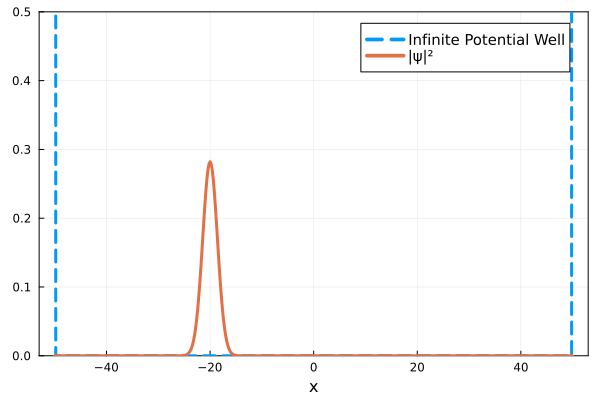

In [435]:
using QuadGK
using Plots
include("/Users/kedarmal/Desktop/Project1/Group10/simpsons.jl")

# Initial wave function
f(x) = exp(-(x-x0)^2/(2*sigma^2))*exp(im*(k_x*x))


value = simpsons(x -> abs(f(x)*conj(f(x))),a,b,n)
println("Normalization using simpsons rule = ",value)

integral, err = quadgk(x -> abs2(f(x)), a, b, rtol=1e-9)
println("Normalization using quadGK = ",(integral,err))
@show rel_error = abs(integral-value)*100

A = 1.0/sqrt(value)                                        # Normalization constant

# Normalized wave function
f(x) = A*exp(-(x-x0)^2/(2*sigma^2))*exp(im*(k_x*x))
println("Total Probability:", simpsons(x -> abs(f(x)*conj(f(x))),a,b,n))


psi0 = @. A*exp(-(x-x0)^2/(2*sigma^2))*exp(im*(k_x*x))     # wave function at time t = 0

# Make a plot of psi0 and V 
plot(x, potential_vals;lw = 3,ls=:dash,label = "Infinite Potential Well",xlabel = "x",legend=:topright, legendfontsize=10,framestyle = :box)
plot!(x, @.abs(psi0)^2;lw=3,label = "|ψ|²")
ylims!(0,0.5)


### Table of CN coefficients

In [436]:
include("/Users/kedarmal/Desktop/Project1/Group10/coeff_2kth_derivative.jl")
## Table of CN coefficients
for i = 1:5
    println("r = $i", " ⇢ ", coeff_2kth_derivative(i))
end

r = 1 ⇢ Rational[-2//1, 1//1]
r = 2 ⇢ Rational[-5//2, 4//3, -1//12]
r = 3 ⇢ Rational[-49//18, 3//2, -3//20, 1//90]
r = 4 ⇢ Rational[-205//72, 8//5, -1//5, 8//315, -1//560]
r = 5 ⇢ Rational[-5269//1800, 5//3, -5//21, 5//126, -5//1008, 1//3150]


### Generate the matrix K from given potential
   Ψ_{n+1} = K * Ψ_n
   where K = inv(A)*conj(A)

In [437]:
include("/Users/kedarmal/Desktop/Project1/Group10/Time_Evolution_Matrix.jl")

Time_Evolution_Matrix (generic function with 1 method)

### Evolve the wavefunction

In [438]:
K = Time_Evolution_Matrix(potential_vals; r=3, dt=dt, dx=dx, m=m, hbar=hbar)
psi0 = @. A*exp(-(x-x0)^2/(2*sigma^2))*exp(im*(k_x*x))
psi_grid = psi0

for t in 2:length(t_vals)
    psi_grid = hcat(psi_grid, K * psi_grid[:,t-1])
end
plot(x, potential_vals;lw = 3,ls=:dash,label = "Infinite_Potential",xlabel = "x",legend=:topright, legendfontsize=10,framestyle = :box)
plot!(x, @.abs(psi_grid)^2;lw=3,label = "|ψ(t,x)|²",legend=false)
ylims!(0,1)


[ Info: Saved animation to /Users/kedarmal/tmp.gif


Plots.AnimatedGif("/Users/kedarmal/tmp.gif")
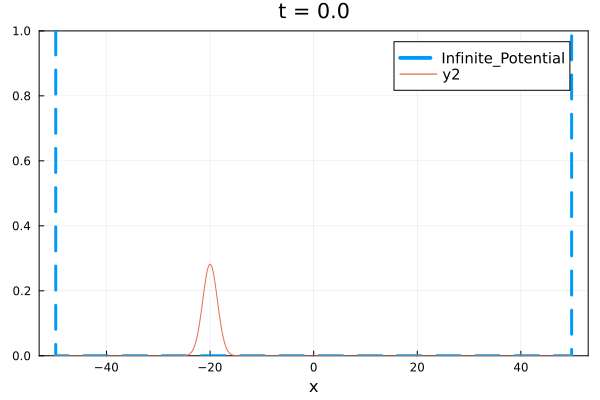

In [439]:
@gif for t in 1:length(t_vals)    
    plot(x, potential_vals;lw = 3,ls=:dash,label = "Infinite_Potential",xlabel = "x",legend=:topright, legendfontsize=10,framestyle = :box)
    plot!(x,@.abs(psi_grid[:,t])^2)
    title!("t = $(round(t_vals[t], digits = 2))")
    ylims!(0,1)
end

In [441]:
Prob = Array{Float64}(undef,length(t_vals))
for t in 1:length(t_vals)    
    Prob[t] = sum(@.abs(psi_grid[:,t])^2)*dx        # Print Total Probability (Should = 1)
end


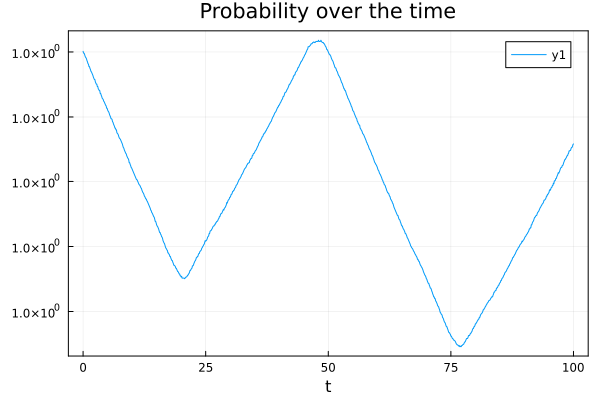

In [442]:
plot(t_vals,Prob,title="Probability over the time",xlabel="t",framestyle=:box)

### Pade Approximants

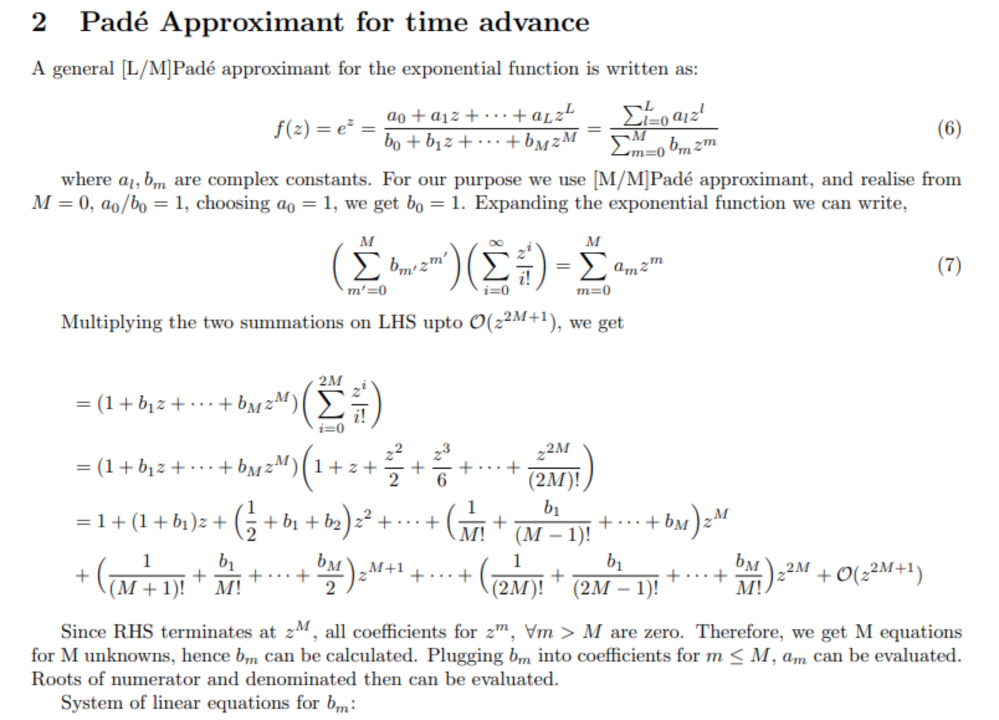

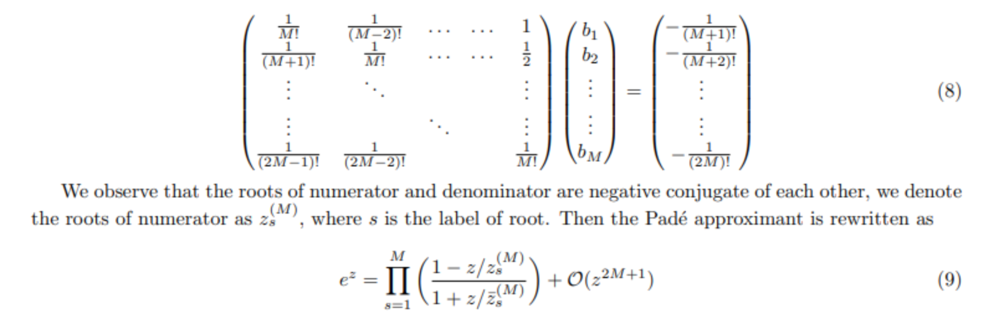

In [410]:
function pade_coeffs_exp(M)
    C = [1//factorial(i+j-1) for i in 1:M, j in 1:M]
    C_right = -[1//factorial(i+M) for i in 1:M]
    coeff = inv(C)*C_right
    b_rev = vcat(coeff,1)
    b = reverse(b_rev)    

    a = []
    s = +1
    for b_ in b
        a = vcat(a, s*b_)
        s = -s
    end

    return Rational.(a), b

end

function roots_pade_exp(M)
    a, b = pade_coeffs_exp(M)
    return roots(a), roots(b)
end

roots_pade_exp (generic function with 1 method)

In [411]:
## Table for Pade Roots
for i = 1:5
    a_roots, b_roots = roots_pade_exp(i)
    println("M = ", i, " ⇢ ", round.(a_roots, digits = 2))
    #println("M = ", i, " -> ", round.(b_roots, digits = 2))
end
     

M = 1 ⇢ ComplexF64[-2.0 + 0.0im]
M = 2 ⇢ ComplexF64[-3.0 - 1.73im, -3.0 + 1.73im]
M = 3 ⇢ ComplexF64[-3.68 - 3.51im, -4.64 + 0.0im, -3.68 + 3.51im]
M = 4 ⇢ ComplexF64[-4.21 - 5.31im, -5.79 - 1.73im, -5.79 + 1.73im, -4.21 + 5.31im]
M = 5 ⇢ ComplexF64[-4.65 + 7.14im, -7.29 + 0.0im, -6.7 - 3.49im, -4.65 - 7.14im, -6.7 + 3.49im]


In [409]:
a_roots

3-element Vector{ComplexF64}:
 -3.6778146453739136 - 3.5087619195674438im
  -4.644370709252173 + 9.481934467055623e-16im
  -3.677814645373913 + 3.508761919567443im

In [424]:
function get_pade_time_evolution_matrix(potential_vals; M=1, r = 3, dt=dt, dx=dx, m=m, hbar=hbar)
    K = 1I
    a_roots,_ = roots_pade_exp(M)
    for s in 1:M
        Ks = Time_Evolution_Matrix(potential_vals; r=r, z_s = a_roots[s], dt=dt, dx=dx, m=m, hbar=hbar)
        K = K*Ks
    end
    return K
end
     

get_pade_time_evolution_matrix (generic function with 1 method)

[ Info: Saved animation to /Users/kedarmal/tmp.gif


Plots.AnimatedGif("/Users/kedarmal/tmp.gif")
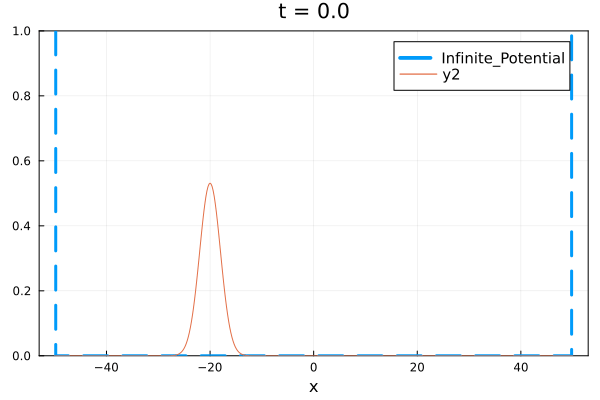

In [432]:
potential_vals = @. potential_well(x)
psi_grid = copy(psi0)

M = 5
r = 3
K = get_pade_time_evolution_matrix(potential_vals; M=M, r=r, dt=dt, dx=dx, m=m, hbar=hbar)

for t_i in 2:length(t_vals)
    psi_grid = hcat(psi_grid, K * psi_grid[:,t_i-1])
end

@gif for t in 1:length(t_vals)
    plot(x, potential_vals;lw = 3,ls=:dash,label = "Infinite_Potential",xlabel = "x",legend=:topright, legendfontsize=10,framestyle = :box)
    plot!(x,abs.(psi_grid[:,t]))
    ylims!(0,1)
    title!("t = $(round(t_vals[t], digits = 2))")
end
    